In [2]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from torch import nn
import torch.nn.functional as F


import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 

import sys, time
import csv
import string
import os
import shutil
from pathlib import Path
import re
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
from sklearn.model_selection import LeaveOneOut
import statistics
from tqdm import tqdm
import cv2
from IPython.display import HTML
from base64 import b64encode
from joblib import Parallel, delayed
import multiprocessing
import imageio
from PIL import Image
%matplotlib inline

In [2]:
print('pytorch version:',torch.__version__)

pytorch version: 1.4.0


In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('GPU Availability:', device)

GPU Availability: cuda


In [4]:
data_dir_base_path = Path('/data/research_data/dfdc_train_data')
# data_dir_base_path = '/data/research_data/dfdc_sample_data/train_sample_videos'

metadata_filename = 'metadata.csv'
df = pd.read_csv(f'{str(data_dir_base_path)}/{metadata_filename}')
print('shape', df.shape)
df[df['label']=='REAL'].head()

shape (119154, 4)


,filename,label,original,split
8,advzryyfkn.mp4,REAL,NaN,train
17,agvtpygfdc.mp4,REAL,NaN,train
23,almnilnfyu.mp4,REAL,NaN,train
28,anznojhdjf.mp4,REAL,NaN,train
32,aqzbhxohjk.mp4,REAL,NaN,train


label
FAKE    323
REAL     77
Name: filename, dtype: int64


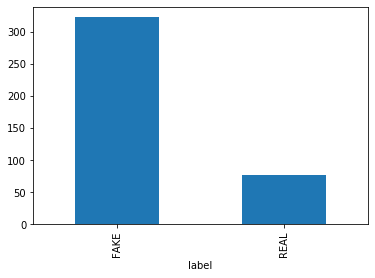

In [48]:
print(df.groupby(['label']).count()['filename'])
df.groupby(['label']).count()['filename'].plot(kind='bar')

       filename  split  original
label                           
FAKE        323    323       323
REAL         77     77         0


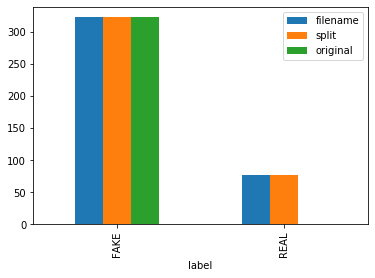

In [49]:
print(df.groupby(['label']).count())
df.groupby(['label']).count().plot(kind='bar')

In [50]:
def getLength(filename):
    cap = cv2.VideoCapture(filename)
    fps = cap.get(cv2.CAP_PROP_FPS)      # OpenCV2 version 2 used "CV_CAP_PROP_FPS"
    if(fps<10):
        print(fps, filename)
        return 0, 0
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = frame_count/fps

#     print('fps = ' + str(fps))
#     print('number of frames = ' + str(frame_count))
#     print('duration (S) = ' + str(duration))
    minutes = int(duration/60)
    seconds = duration%60
#     print('duration (M:S) = ' + str(minutes) + ':' + str(seconds))

    cap.release()
    return duration, frame_count


In [51]:
def compute_histogram_bins(data, desired_bin_size):
    min_val = np.min(data)
    max_val = np.max(data)
    min_boundary = -1.0 * (min_val % desired_bin_size - min_val)
    max_boundary = max_val - max_val % desired_bin_size + desired_bin_size
    n_bins = int((max_boundary - min_boundary) / desired_bin_size) + 1
    bins = np.linspace(min_boundary, max_boundary, n_bins)
    return bins

In [52]:
num_cores = multiprocessing.cpu_count()
print('Total compute core', num_cores)

Total compute core 28


In [53]:
iteration = 0

temp_df = df.copy(deep=True)
temp_df['video_file_length'] = np.nan
temp_df['original_video_file_length'] = np.nan
temp_df['video_frames_num'] = np.nan
temp_df['original_video_frames_num'] = np.nan
total_files = temp_df.shape[0]

for index,row in df.iterrows():
    duration, frame_count = getLength(f'{str(data_dir_base_path)}/{str(row["filename"])}')
    temp_df.at[index,'video_file_length'] = duration
    temp_df.at[index,'video_frames_num'] = frame_count
    if(not pd.isna(row['original'])):
        duration, frame_count = getLength(f'{str(data_dir_base_path)}/{str(row["original"])}')
        temp_df.at[index, 'original_video_file_length'] = duration
        temp_df.at[index, 'original_video_frames_num'] = frame_count
                    
    iteration = iteration + 1
    if(iteration%1000==0):
        print('Complete {}/{} ({:.3f})'.format(iteration, total_files, iteration/total_files))
print('Video Len Parsing Completed')

0.0 /data/research_data/dfdc_sample_data/train_sample_videos/vudstovrck.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/jdubbvfswz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/qzimuostzz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/kbvibjhfzo.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/fjlyaizcwc.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/ffcwhpnpuw.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/slwkmefgde.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/fysyrqfguw.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/qjlhemtkxk.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/qzimuostzz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/proiippuup.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/gxembgiarp.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/iufotyxgzb.mp4
0.0 /data/re

0.0 /data/research_data/dfdc_sample_data/train_sample_videos/fhghkqdkhe.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/mmhqllmlew.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/ywvlvpvroj.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/xzvrgckqkz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/gktjowiuqe.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/gipbyjfxfp.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/liniegczcx.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/ifjktxxiln.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/kgbkktcjxf.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/nvpluswotp.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/fdcttsvjwf.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/sqwvfgwdxr.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/vgqotmftcr.mp4
0.0 /data/re

0.0 /data/research_data/dfdc_sample_data/train_sample_videos/imzqmbfugn.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/yoavqsqobz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/pylnolwenx.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/xwcggrygwl.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/pqvypayzrp.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/lyvlnqduqg.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/yjlsxqoauz.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/iufotyxgzb.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/fysyrqfguw.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/kgbkktcjxf.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/grnycmbdfu.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/kysxawkest.mp4
0.0 /data/research_data/dfdc_sample_data/train_sample_videos/xngpzquyhs.mp4
0.0 /data/re

In [54]:
temp_df.head()

,filename,label,split,original,video_file_length,original_video_file_length,video_frames_num,original_video_frames_num
0,aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4,10.01001,0.00000,300.0,0.0
1,aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4,10.01001,0.00000,300.0,0.0
2,abarnvbtwb.mp4,REAL,train,NaN,10.01001,NaN,300.0,NaN
3,abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4,10.01001,10.01001,300.0,300.0
4,abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4,10.01001,0.00000,300.0,0.0


In [38]:
temp_df.to_csv(f'{data_dir_base_path}/train.csv', index=False)

(array([   200.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0.,      0., 118954.]),
 array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11.]),
 <a list of 11 Patch objects>)

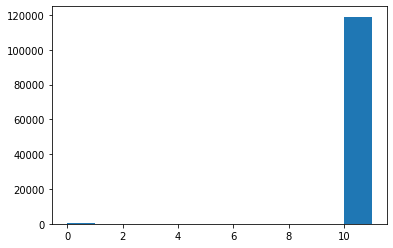

In [32]:
plt.hist(temp_df['video_file_length'], bins=compute_histogram_bins(temp_df['video_file_length'], 1) )

In [41]:
def play_video(filename):
    vid = open(filename,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(vid).decode()
    HTML("""
    <video width=600 controls>
          <source src="%s" type="video/mp4">
    </video>
    """ % data_url)

In [62]:
filename = f'{data_dir_base_path}/mcchrddyxx.mp4'
vid = open(filename,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(vid).decode()
HTML("""<video width=600 controls>
    <source src="%s" type="video/mp4">
    </video>""" % data_url)

In [45]:
filename = f'{data_dir_base_path}/gjasrapdle.mp4'
vid = open(filename,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(vid).decode()
HTML("""<video width=600 controls>
    <source src="%s" type="video/mp4">
    </video>""" % data_url)

In [3]:
class Video:
    def __init__(self, path, seq_max_len=None, transforms=None):
        self.path = path
        self.seq_max_len = seq_max_len
        self.transforms = transforms
        self.container = imageio.get_reader(path, 'ffmpeg')
        self.length = self.container.count_frames()
        self.fps = self.container.get_meta_data()['fps']

    def get_all_frames(self):
        self.init_head()
        frames = []
        face_frames = []

        for idx, frame in enumerate(self.container):
            tm_face_frames = self.get_face_frames(frame)
            for face_frame in tm_face_frames:
                face_frames.append(face_frame)
                
            frame = Image.fromarray(frame)
            if (self.transforms != None):
                frame = self.transforms(frame)
            frames.append(frame)

        seq = torch.stack(frames, dim=0).float()
        seq_len = seq.size(0)
        self.container.close()
        return seq, seq_len

    def get_face_frames(self, frame):
        face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
        face_locations = face_cascade.detectMultiScale(frame, 1.3, 5)

#         face_locations = face_recognition.face_locations(frame)
        frames = []
        for face_location in face_locations:
            x, y, w, h = face_location
            face_image = image[y:y+h, x:x+w]
            frames.append(face_image)
        return frames
    
    def init_head(self):
        self.container.set_image_index(0)

    def next_frame(self):
        self.container.get_next_data()

    def get(self, key):
        return self.container.get_data(key)

    def __call__(self, key):
        return self.get(key)

    def __len__(self):
        return self.length

rgb_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )])

video = Video('/data/research_data/dfdc_sample_data/train_sample_videos/aagfhgtpmv.mp4', transforms=rgb_transforms)
face = video.get_all_frames()[2]
fig, ax = plt.subplots(1,1, figsize=(5, 5))
plt.grid(False)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.imshow(face)

error: OpenCV(4.2.0) /io/opencv/modules/objdetect/src/cascadedetect.cpp:1689: error: (-215:Assertion failed) !empty() in function 'detectMultiScale'
